In [217]:
import warnings

warnings.filterwarnings("ignore")

import os
import re
import matplotlib.pyplot as plt
import seaborn as sns
import scanpy as sc
import pandas as pd
import numpy as np
import random
import sc_toolbox
# import pertpy 
import anndata as ad
import scanpy.external as sce
from scipy import sparse

import rpy2.rinterface_lib.callbacks
import anndata2ri
import logging

from rpy2.robjects import pandas2ri
from rpy2.robjects import r

rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

pandas2ri.activate()
anndata2ri.activate()

%load_ext rpy2.ipython

The rpy2.ipython extension is already loaded. To reload it, use:
  %reload_ext rpy2.ipython


In [30]:
import preprocessing
import plots

In [193]:
sc.settings.verbosity = 0
sc.set_figure_params(dpi=150, dpi_save=300, frameon=False, format='png')
pd.set_option('display.max_rows', 500)
plt.rcParams['axes.grid'] = False

### Create adata object

In [9]:
donors = os.listdir('./single_matrices')
donors.extend(os.listdir('./single_matrices/65+'))
young = []
old = []

young_ages = []
old_ages = []

min_young_age = 36
max_old_age = 70

for donor in donors:
    pattern = r'(\d{2})-(?:Male|Female)\.h5ad$'
    match = re.search(pattern, donor)
    if match:
        age = int(match.group(1))
        if age <= 35:
            young.append(donor)
            young_ages.append(age)
        if age >= 70:
            old.append(donor)
            old_ages.append(age)
print(f"{len(young)} young donors from {np.min(young_ages)} to {np.max(young_ages)} years")
print(f"{len(old)} old donors from {np.min(old_ages)} to {np.max(old_ages)} years")

152 young donors from 19 to 35 years
424 old donors from 70 to 97 years


In [10]:
young_adatas = []
for donor in young:
    adata = sc.read_h5ad(os.path.join('./single_matrices', donor))
    young_adatas.append(adata)
adata_young = ad.concat(young_adatas, join='outer')
adata_young.obs['age_group'] = 'Young'

In [19]:
old_adatas = []
old_subset = old
for donor in old_subset:
    adata = sc.read_h5ad(os.path.join('./single_matrices/65+', donor))
    old_adatas.append(adata)
adata_old = ad.concat(old_adatas, join='outer')
adata_old.obs['age_group'] = 'Old'

In [14]:
adata_young

AnnData object with n_obs × n_vars = 478044 × 32852
    obs: 'pool_number', 'donor_id', 'ct_cov', 'age', 'sex', 'ethnicity', 'dataset', 'nCount_RNA', 'nFeature_RNA', 'predicted.celltype.l2', 'predicted.celltype.l2.score', 'age_group'

In [20]:
adata_old

AnnData object with n_obs × n_vars = 538439 × 32852
    obs: 'nCount_RNA', 'nFeature_RNA', 'donor_id', 'pool_number', 'predicted.celltype.l2', 'predicted.celltype.l2.score', 'age', 'sex', 'dataset', 'ct_cov', 'ethnicity', 'age_group'

In [21]:
adata = ad.concat([adata_young, adata_old], join='outer')

In [23]:
adata.obs.drop(columns=['nCount_RNA', 'nFeature_RNA', 
                        'predicted.celltype.l2', 'predicted.celltype.l2.score'],
               inplace=True)

In [257]:
adata

AnnData object with n_obs × n_vars = 941027 × 5000
    obs: 'pool_number', 'donor_id', 'ct_cov', 'age', 'sex', 'ethnicity', 'dataset', 'age_group', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'outlier', 'mt_outlier', 'n_genes', 'leiden', 'ct_annotation', 'ct_conf_score'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'leiden', 'dendrogram_leiden', 'paga', 'leiden_sizes', 'umap', 'leiden_colors', 'sex_colors', 'dataset_colors', 'age_group_colors', 'ct_annotation_colors'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'co

In [27]:
# to fix the `TypeError` when writing to .h5ad 
adata.obs['pool_number'] = [str(n) for n in adata.obs['pool_number']]
adata.obs['age'] = [float(n) for n in adata.obs['age']]

In [28]:
# !mkdir ages_output
output_path='./ages_output'
adata.write(os.path.join(output_path, 'adata_concatenated_raw.h5ad'))

### Preprocessing

Total number of cells: 1016483
Number of cells after filtering of low quality cells: 941027

Normalizing, logarithming...

Select HVG...


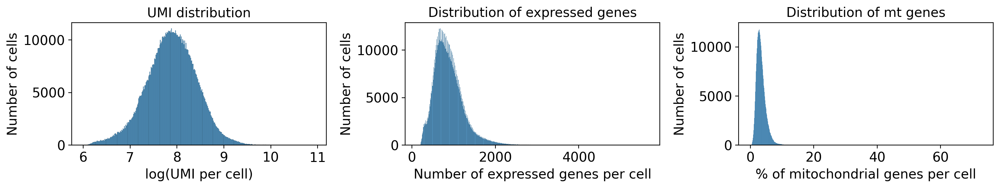

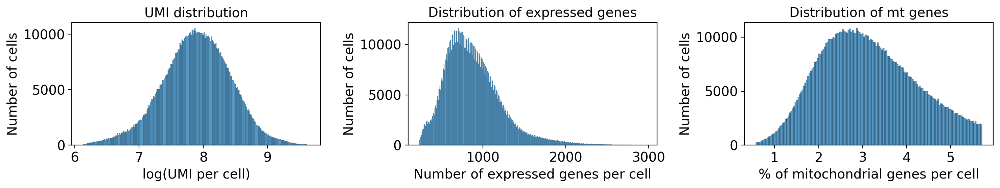

In [34]:
adata = preprocessing.qc_and_preprocess_to_pca(adata, output_dir=output_path)

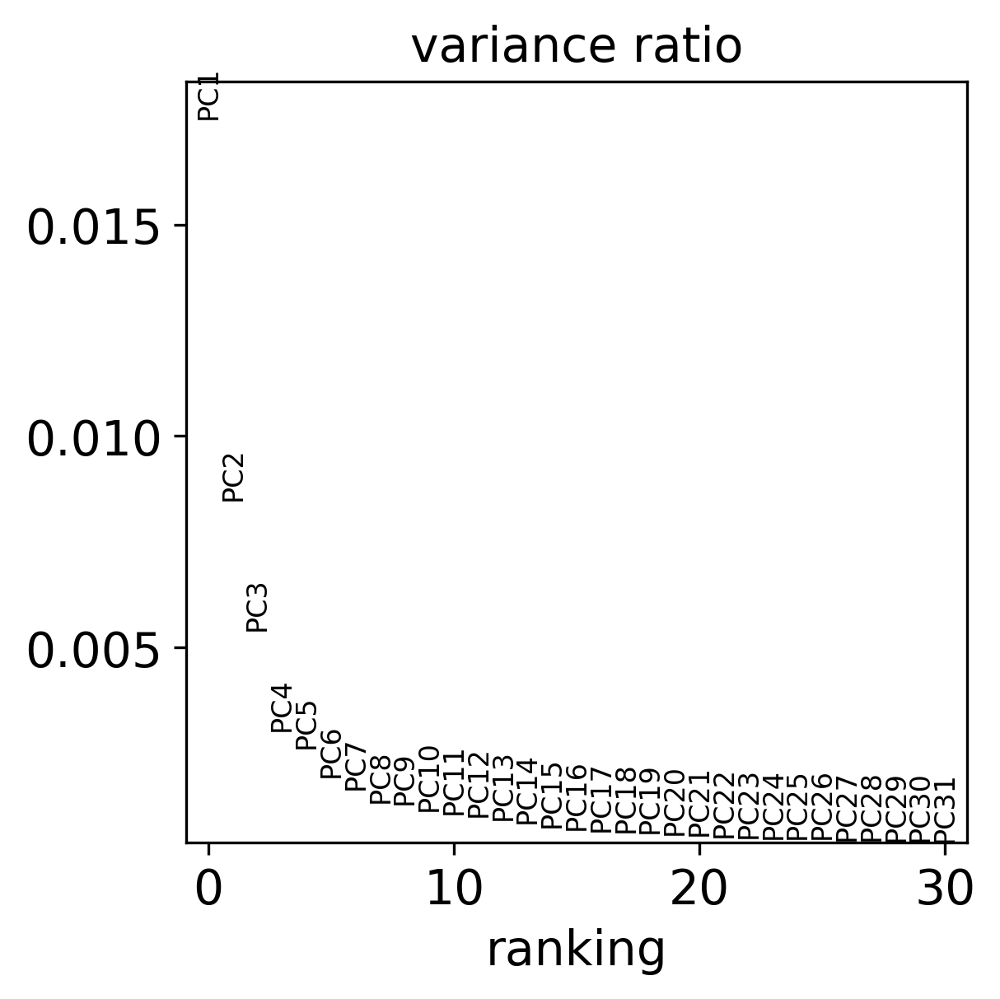

In [35]:
sc.pl.pca_variance_ratio(adata)

In [36]:
adata.write(os.path.join(output_path, 'adata_ages_PCA.h5ad'))

In [2]:
adata = sc.read_h5ad(os.path.join(output_path, 'adata_ages_PCA.h5ad'))

In [37]:
# BATCH CORRECTION 
sce.pp.harmony_integrate(adata, 'donor_id', max_iter_harmony=20)

2024-05-10 05:22:49,257 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-05-10 05:23:30,412 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-05-10 05:23:35,520 - harmonypy - INFO - Iteration 1 of 20
2024-05-10 05:48:12,897 - harmonypy - INFO - Iteration 2 of 20
2024-05-10 06:11:54,908 - harmonypy - INFO - Iteration 3 of 20
2024-05-10 06:35:46,538 - harmonypy - INFO - Iteration 4 of 20
2024-05-10 06:59:10,012 - harmonypy - INFO - Iteration 5 of 20
2024-05-10 07:22:13,911 - harmonypy - INFO - Iteration 6 of 20
2024-05-10 07:40:05,488 - harmonypy - INFO - Converged after 6 iterations


In [38]:
adata.write(os.path.join(output_path, 'adata_main_harmony.h5ad'))

In [40]:
%%time
# CLUSTERING
sc.pp.neighbors(
    adata,
    n_pcs=20,
    n_neighbors=15,
    knn=True,
    use_rep="X_pca_harmony"
)

CPU times: user 2min 38s, sys: 2.77 s, total: 2min 40s
Wall time: 2min 41s


In [44]:
%%time
sc.tl.leiden(adata, resolution=0.6, flavor='igraph')
sc.tl.dendrogram(adata, groupby="leiden", n_pcs=20, use_rep="X_pca_harmony", linkage_method="single")

CPU times: user 37.8 s, sys: 1.39 s, total: 39.2 s
Wall time: 39.4 s


In [42]:
sc.tl.paga(adata)
sc.pl.paga(adata, plot=False)
sc.tl.umap(adata, init_pos='paga')

In [45]:
adata.write(os.path.join(output_path, 'adata_leiden_main.h5ad'))

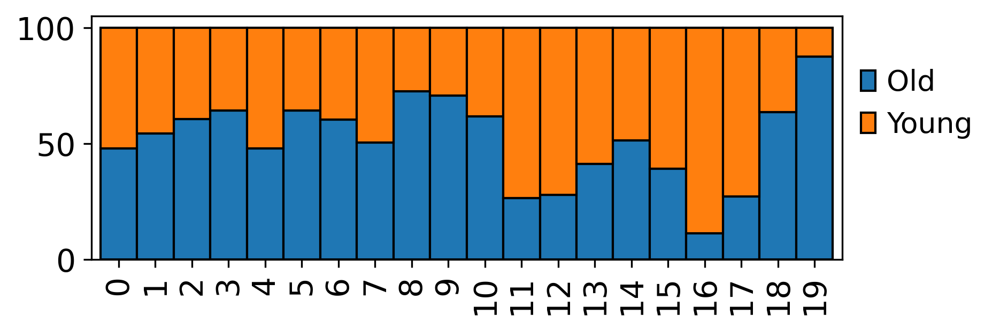

In [56]:
plots.barplot(adata=adata, cluster_key="leiden", batch_key="age_group")

In [3]:
adata = sc.read_h5ad(os.path.join(output_path, 'adata_leiden_main.h5ad'))

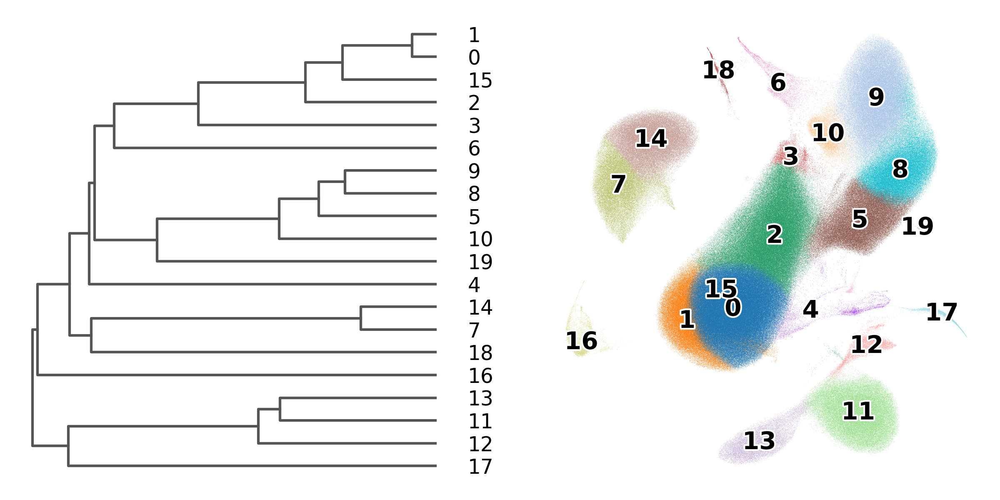

In [46]:
plots.plot_leiden_clusters(adata)

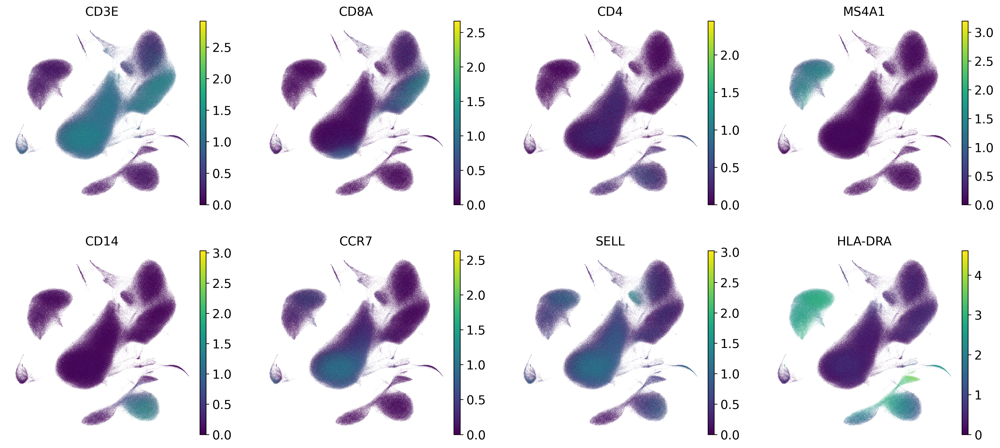

In [51]:
sc.pl.umap(adata, color=['CD3E', 'CD8A', 'CD4', 'MS4A1', 
                         'CD14', 'CCR7', 'SELL', 'HLA-DRA'], frameon=False)

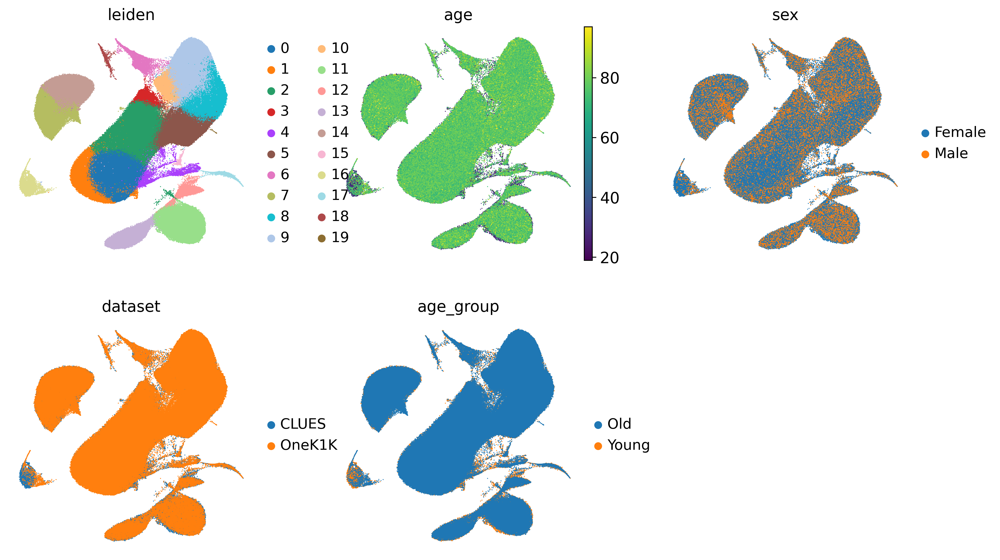

In [57]:
sc.pl.umap(adata, color=['leiden', 'age', 'sex', 'dataset', 'age_group'], 
           frameon=False, ncols=3, size=3, sort_order=False)

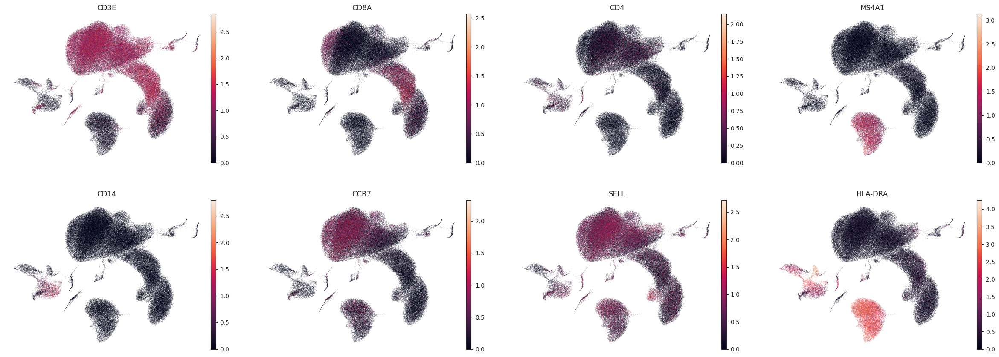

In [7]:
sc.pl.umap(adata, color=['CD3E', 'CD8A', 'CD4', 'MS4A1', 
                         'CD14', 'CCR7', 'SELL', 'HLA-DRA'], frameon=False)

### Annotation

In [47]:
import celltypist
from celltypist import models

In [48]:
adata_celltypist = adata.copy()  # make a copy of our adata
adata_celltypist.X = adata.layers["counts"].copy()  # set adata.X to raw counts
sc.pp.normalize_per_cell(adata_celltypist, counts_per_cell_after=10**4)  # normalize to 10,000 counts per cell
sc.pp.log1p(adata_celltypist)  # log-transform
# make .X dense instead of sparse, for compatibility with celltypist:
adata_celltypist.X = adata_celltypist.X.toarray()

In [ ]:
# models.download_models(force_update = True)

In [50]:
model_pbmc = models.Model.load(model="Healthy_COVID19_PBMC.pkl")

In [58]:
model_pbmc.cell_types

array(['ASDC', 'B_exhausted', 'B_immature', 'B_malignant', 'B_naive',
       'B_non-switched_memory', 'B_switched_memory', 'C1_CD16_mono',
       'CD14_mono', 'CD16_mono', 'CD4.CM', 'CD4.EM', 'CD4.IL22',
       'CD4.Naive', 'CD4.Prolif', 'CD4.Tfh', 'CD4.Th1', 'CD4.Th17',
       'CD4.Th2', 'CD8.EM', 'CD8.Naive', 'CD8.Prolif', 'CD8.TE',
       'CD83_CD14_mono', 'DC1', 'DC2', 'DC3', 'DC_prolif', 'HSC_CD38neg',
       'HSC_CD38pos', 'HSC_MK', 'HSC_erythroid', 'HSC_myeloid',
       'HSC_prolif', 'ILC1_3', 'ILC2', 'MAIT', 'Mono_prolif', 'NKT',
       'NK_16hi', 'NK_56hi', 'NK_prolif', 'Plasma_cell_IgA',
       'Plasma_cell_IgG', 'Plasma_cell_IgM', 'Plasmablast', 'Platelets',
       'RBC', 'Treg', 'gdT', 'pDC'], dtype=object)

In [59]:
%%time
ct_preds = celltypist.annotate(
    adata_celltypist,
    model=model_pbmc,
    majority_voting=True
)

🔬 Input data has 941027 cells and 5000 genes
🔗 Matching reference genes in the model
🧬 1692 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 30
🗳️ Majority voting the predictions
✅ Majority voting done!


CPU times: user 2h 18min 17s, sys: 2min 52s, total: 2h 21min 10s
Wall time: 2h 19min 16s


In [60]:
ct_preds_adata = ct_preds.to_adata()

In [61]:
adata.obs["ct_annotation"] = ct_preds_adata.obs.loc[adata.obs.index, "majority_voting"]
adata.obs["ct_conf_score"] = ct_preds_adata.obs.loc[adata.obs.index, "conf_score"]

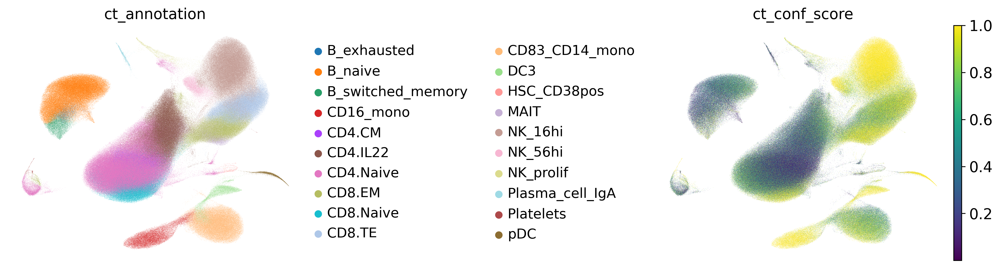

In [62]:
sc.pl.umap(
    adata,
    color=["ct_annotation", "ct_conf_score"],
    frameon=False,
    sort_order=False,
    wspace=1,
    groups=['MAIT', 'CD8.Naive']
)

In [64]:
adata.write(os.path.join(output_path, 'adata_main_annotated.h5ad'))

In [65]:
adata.obs['ct_annotation'].value_counts()

CD4.Naive            298288
NK_16hi              121458
CD4.IL22             109962
B_naive               94232
CD8.TE                66416
CD83_CD14_mono        60782
CD8.EM                56411
CD8.Naive             48484
CD16_mono             20570
MAIT                  14650
CD4.CM                11715
DC3                    9430
NK_56hi                9286
B_switched_memory      7853
pDC                    3607
B_exhausted            2700
NK_prolif              2381
Plasma_cell_IgA        1696
HSC_CD38pos             693
Platelets               413
Name: ct_annotation, dtype: int64

### CD8 cell types selection

In [150]:
adata_cd8 = adata[[type in ('CD8.Naive', 'CD8.EM', 'CD8.TE', 'MAIT') for type in adata.obs['ct_annotation']]]

In [151]:
adata_cd8

View of AnnData object with n_obs × n_vars = 185961 × 5000
    obs: 'pool_number', 'donor_id', 'ct_cov', 'age', 'sex', 'ethnicity', 'dataset', 'age_group', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'outlier', 'mt_outlier', 'n_genes', 'leiden', 'ct_annotation', 'ct_conf_score'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'leiden', 'dendrogram_leiden', 'paga', 'leiden_sizes', 'umap', 'leiden_colors', 'sex_colors', 'dataset_colors', 'age_group_colors', 'ct_annotation_colors'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distanc

In [152]:
(adata_cd8.X.T[adata_cd8.var_names == 'CD4'] > 1).sum()

6648

In [153]:
# drop CD4+ cells:
adata_cd8 = adata_cd8[adata_cd8.X.T[adata_cd8.var_names == 'CD4'] < 1]

In [154]:
adata_cd8

View of AnnData object with n_obs × n_vars = 179313 × 5000
    obs: 'pool_number', 'donor_id', 'ct_cov', 'age', 'sex', 'ethnicity', 'dataset', 'age_group', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'outlier', 'mt_outlier', 'n_genes', 'leiden', 'ct_annotation', 'ct_conf_score'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'leiden', 'dendrogram_leiden', 'paga', 'leiden_sizes', 'umap', 'leiden_colors', 'sex_colors', 'dataset_colors', 'age_group_colors', 'ct_annotation_colors'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distanc

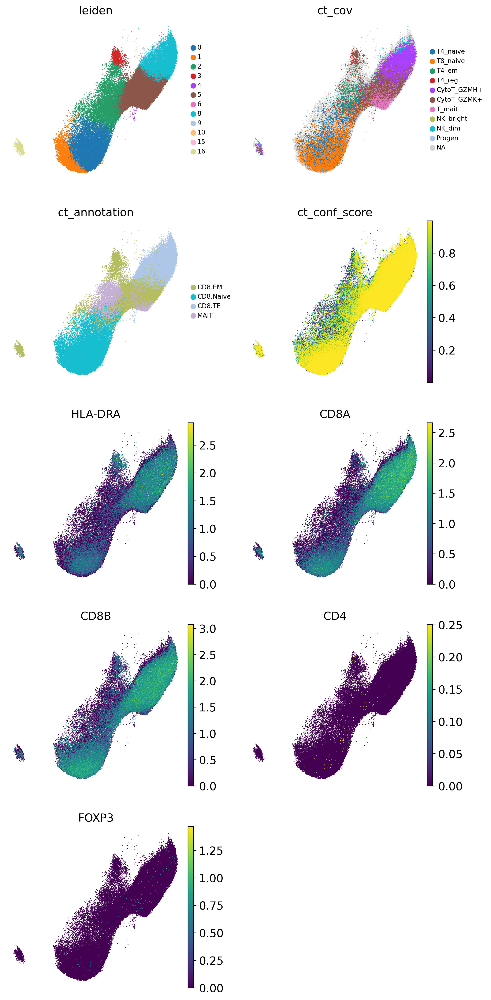

In [155]:
sc.pl.umap(adata_cd8, 
           color=['leiden', 'ct_cov', 'ct_annotation', 'ct_conf_score', 'HLA-DRA', 'CD8A', 'CD8B', 'CD4', 'FOXP3'], 
           ncols=2, size=4, legend_fontsize=8
           )

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


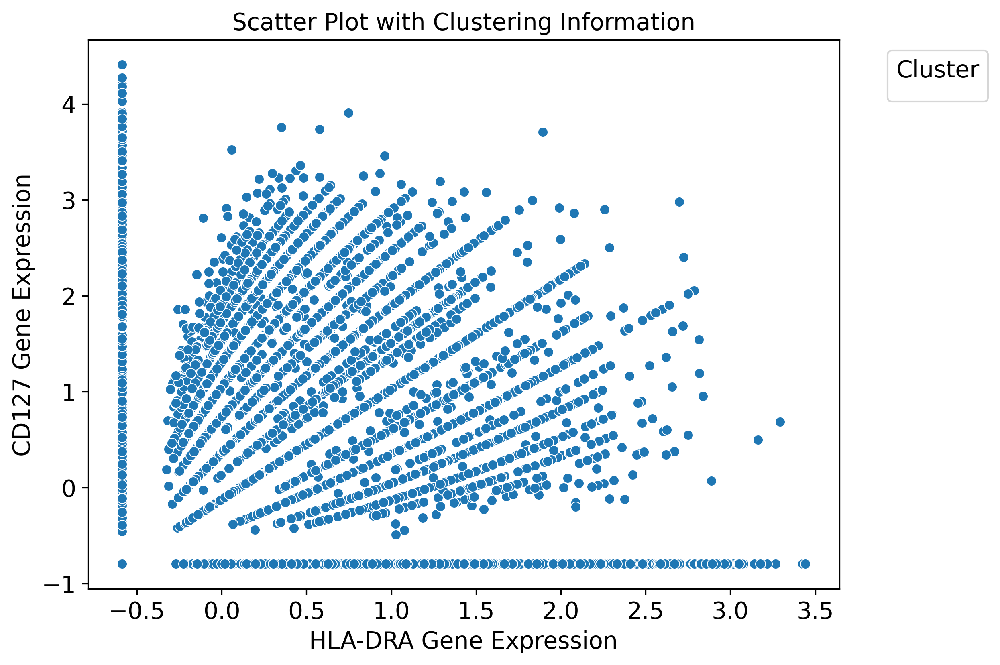

In [96]:
plt.figure(figsize=(8, 6))
colordict = {False: '#DDE2E6', True: '#D649B0'}
sns.scatterplot(x=adata_cd8.X.T[adata_cd8.var_names == 'HLA-DRB1'][0],
                y=adata_cd8.X.T[adata_cd8.var_names == 'IL7R'][0], 
                # hue=adata_cd8.obs['leiden_cd8'] == '5',
                palette=colordict)

plt.xlabel('HLA-DRA Gene Expression')
plt.ylabel('CD127 Gene Expression')
plt.title('Scatter Plot with Clustering Information')

plt.legend(title='Cluster', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.show()

In [158]:
%%time

filtered = adata_cd8[(np.greater_equal(adata_cd8.X.T[adata_cd8.var_names == 'HLA-DRA'], 0.5) 
                      | np.greater_equal(adata_cd8.X.T[adata_cd8.var_names == 'HLA-DRB1'], 0.5)
                      | np.greater_equal(adata_cd8.X.T[adata_cd8.var_names == 'HLA-DRB5'], 0.5))
                    & np.less(adata_cd8.X.T[adata_cd8.var_names == 'IL7R'], 0)]
adata_cd8.obs['is_CD8Treg'] = [name in list(filtered.obs_names) for name in adata_cd8.obs_names]

CPU times: user 4min 44s, sys: 121 ms, total: 4min 45s
Wall time: 4min 45s


In [159]:
adata_cd8.obs['is_CD8Treg'].sum()

26765

In [160]:
adata_cd8.uns['is_CD8Treg_colors'] = ['#dfecf5', '#f022ca']

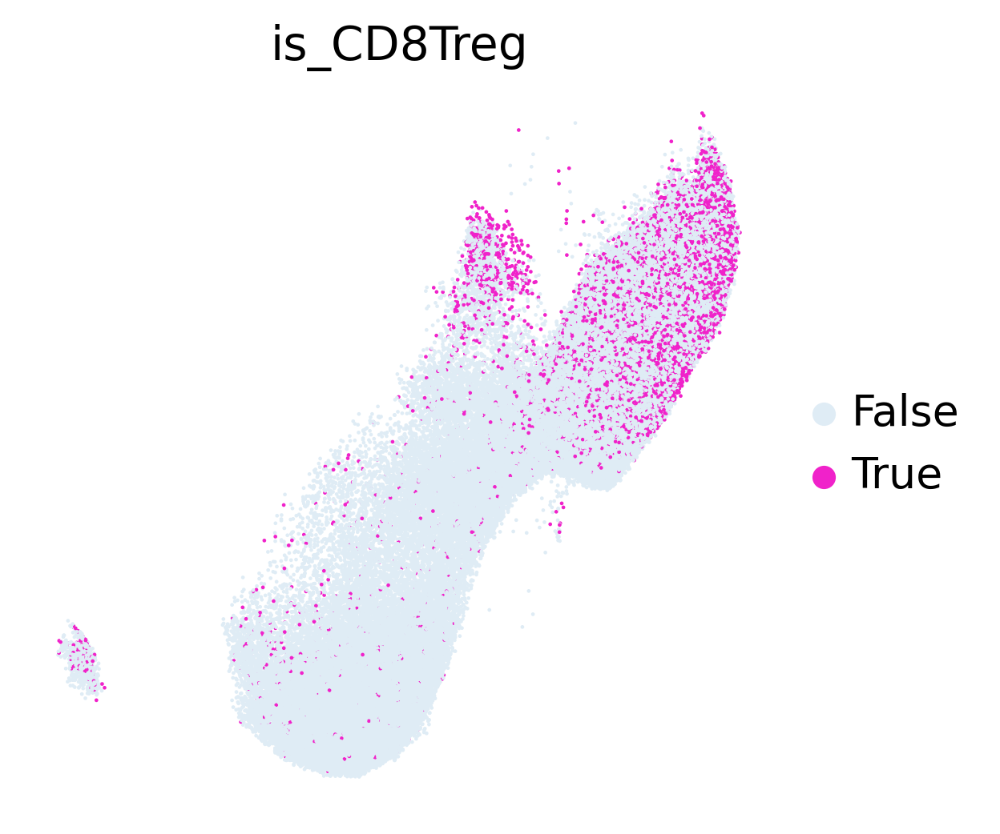

In [161]:
sc.pl.umap(adata_cd8, color=['is_CD8Treg'], size=5)

In [162]:
adata_cd8.obs.value_counts(subset=['ct_annotation', 'is_CD8Treg']) 
# Treg in CD8.EM 13%, in CD8.TE 27%, in Naive 2%, in MAIT 2.5% - TOTAL

ct_annotation  is_CD8Treg
CD8.EM         False         46739
CD8.TE         False         46548
CD8.Naive      False         45785
CD8.TE         True          17456
MAIT           False         13476
CD8.EM         True           7811
CD8.Naive      True           1149
MAIT           True            349
dtype: int64

In [163]:
# IN AGES:
adata_cd8.obs.value_counts(subset=['age_group', 'ct_annotation', 'is_CD8Treg'], sort=False) 
# old: Treg in CD8.EM 15.7%, in CD8.TE 27%, in Naive 1.3%, in MAIT 2.6% 
# young: Treg in CD8.EM 10.7%, in CD8.TE 27.7%, in Naive 3%, in MAIT 2.4% 

age_group  ct_annotation  is_CD8Treg
Old        CD8.EM         False         28827
                          True           5515
           CD8.Naive      False         16365
                          True            214
           CD8.TE         False         33466
                          True          12444
           MAIT           False          7156
                          True            193
Young      CD8.EM         False         17912
                          True           2296
           CD8.Naive      False         29420
                          True            935
           CD8.TE         False         13082
                          True           5012
           MAIT           False          6320
                          True            156
dtype: int64

In [164]:
adata_cd8.obs.value_counts(subset=['age_group', 'is_CD8Treg'], sort=False) 

age_group  is_CD8Treg
Old        False         85814
           True          18366
Young      False         66734
           True           8399
dtype: int64

In [166]:
adata_cd8.obs['dea_labels'] = adata_cd8.obs['ct_annotation'].astype('object')
adata_cd8.obs['dea_labels'][(adata_cd8.obs['is_CD8Treg'] == True) & (adata_cd8.obs['ct_annotation'] != 'CD8.Naive')] = 'CD8.Treg'
adata_cd8.obs['dea_labels'] = adata_cd8.obs['dea_labels'].astype('category')

In [167]:
adata_cd8.write(os.path.join(output_path, 'adata_cd8_filtered_bf_reproc.h5ad'))

#### Re-preprocessing

In [168]:
# return raw counts
adata_cd8.X = adata_cd8.layers['counts'].A.copy()

In [169]:
sc.pp.normalize_total(adata_cd8)
sc.pp.log1p(adata_cd8)

# select HVG, PCA:
sc.pp.highly_variable_genes(
    adata_cd8,
    n_top_genes=2000,
    flavor="seurat_v3",
    layer="counts"
)

adata_cd8 = adata_cd8[:, adata_cd8.var.highly_variable]

sc.pp.scale(adata_cd8)
sc.tl.pca(adata_cd8)

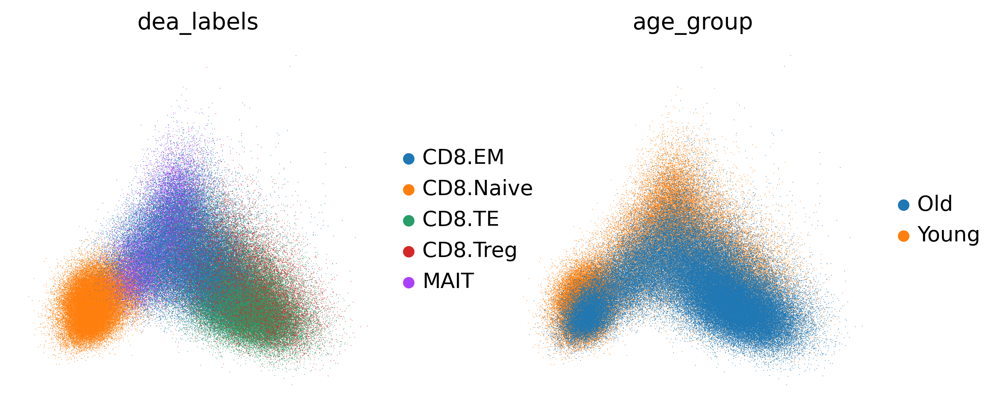

In [170]:
sc.pl.pca_scatter(adata_cd8, color=['dea_labels', 'age_group'])

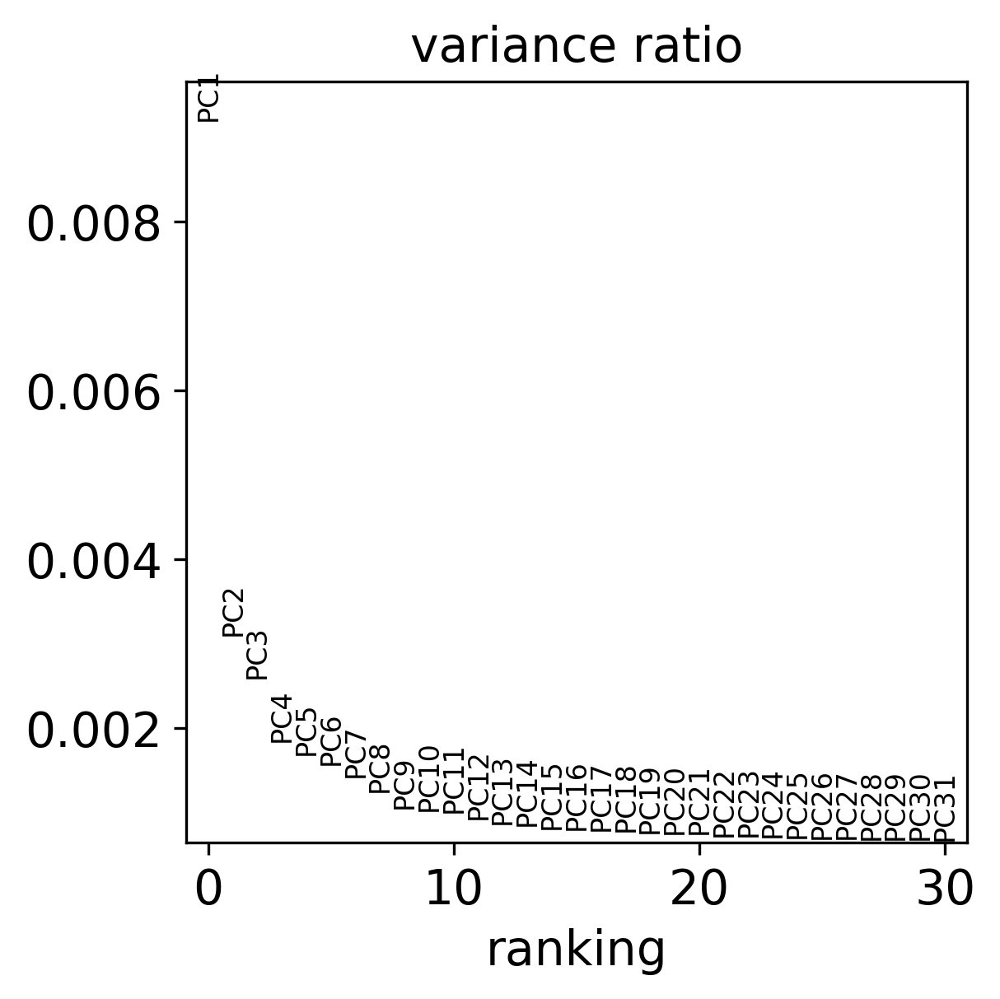

In [172]:
sc.pl.pca_variance_ratio(adata_cd8)

In [173]:
# 3. BATCH CORRECTION
sce.pp.harmony_integrate(adata_cd8, key='donor_id', max_iter_harmony=20)

2024-05-10 22:44:44,194 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
Computing initial centroids with sklearn.KMeans...
2024-05-10 22:44:50,713 - harmonypy - INFO - sklearn.KMeans initialization complete.
sklearn.KMeans initialization complete.
2024-05-10 22:44:51,704 - harmonypy - INFO - Iteration 1 of 20
Iteration 1 of 20
2024-05-10 22:49:29,195 - harmonypy - INFO - Iteration 2 of 20
Iteration 2 of 20
2024-05-10 22:54:06,776 - harmonypy - INFO - Iteration 3 of 20
Iteration 3 of 20
2024-05-10 22:58:45,041 - harmonypy - INFO - Iteration 4 of 20
Iteration 4 of 20
2024-05-10 23:03:21,863 - harmonypy - INFO - Iteration 5 of 20
Iteration 5 of 20
2024-05-10 23:07:06,170 - harmonypy - INFO - Iteration 6 of 20
Iteration 6 of 20
2024-05-10 23:10:43,461 - harmonypy - INFO - Iteration 7 of 20
Iteration 7 of 20
2024-05-10 23:14:14,673 - harmonypy - INFO - Iteration 8 of 20
Iteration 8 of 20
2024-05-10 23:18:54,696 - harmonypy - INFO - Iteration 9 of 20
Iteration 9 of 20

In [174]:
sc.pp.neighbors(
    adata_cd8,
    n_pcs=20,
    n_neighbors=15,
    knn=True,
    use_rep="X_pca_harmony"
)

In [175]:
sc.tl.leiden(adata_cd8, resolution=0.4, flavor='igraph', key_added='leiden_cd8')
sc.tl.dendrogram(adata_cd8, groupby="leiden_cd8", n_pcs=20, use_rep="X_pca_harmony", linkage_method="single")

In [176]:
sc.tl.paga(adata_cd8)
sc.pl.paga(adata_cd8, plot=False)
sc.tl.umap(adata_cd8, init_pos='paga')

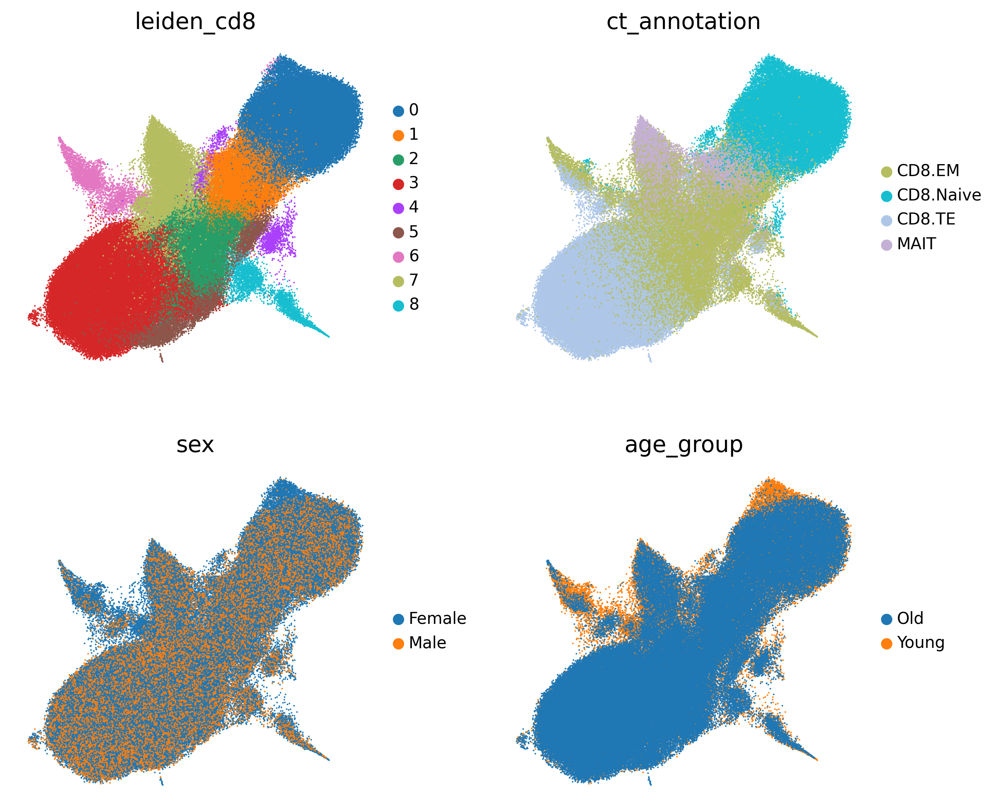

In [177]:
sc.pl.umap(adata_cd8, color=['leiden_cd8', 'ct_annotation', 'sex', 'age_group'], 
           frameon=False, size=4, ncols=2,
           legend_fontsize=10, sort_order=False
          ) 

In [179]:
adata_cd8.write(os.path.join(output_path, 'adata_cd8_treg_tags.h5ad'))

In [178]:
adata_cd8

AnnData object with n_obs × n_vars = 179313 × 2000
    obs: 'pool_number', 'donor_id', 'ct_cov', 'age', 'sex', 'ethnicity', 'dataset', 'age_group', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'outlier', 'mt_outlier', 'n_genes', 'leiden', 'ct_annotation', 'ct_conf_score', 'is_CD8Treg', 'dea_labels', 'leiden_cd8'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'leiden', 'dendrogram_leiden', 'paga', 'leiden_sizes', 'umap', 'leiden_colors', 'sex_colors', 'dataset_colors', 'age_group_colors', 'ct_annotation_colors', 'ct_cov_colors', 'is_CD8Treg_colors', 'dea_labels_colors', 'leide

In [181]:
tregs = adata_cd8[adata_cd8.obs['dea_labels'] == 'CD8.Treg']

In [182]:
tregs

View of AnnData object with n_obs × n_vars = 25616 × 2000
    obs: 'pool_number', 'donor_id', 'ct_cov', 'age', 'sex', 'ethnicity', 'dataset', 'age_group', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'outlier', 'mt_outlier', 'n_genes', 'leiden', 'ct_annotation', 'ct_conf_score', 'is_CD8Treg', 'dea_labels', 'leiden_cd8'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'leiden', 'dendrogram_leiden', 'paga', 'leiden_sizes', 'umap', 'leiden_colors', 'sex_colors', 'dataset_colors', 'age_group_colors', 'ct_annotation_colors', 'ct_cov_colors', 'is_CD8Treg_colors', 'dea_labels_colors',

In [184]:
sc.tl.rank_genes_groups(tregs, groupby='age_group', method='wilcoxon', tie_correct=True, pts=True)

In [187]:
df = sc.get.rank_genes_groups_df(tregs, group='Old', pval_cutoff=0.05)

In [194]:
df = df[~df.names.str.startswith('RP')]
df.sort_values(by='logfoldchanges', ascending=False, inplace=True)
df = df[df.pct_nz_group > 0.01]
df_filt = df[df.logfoldchanges.lt(-0.7) | df.logfoldchanges.gt(0.07)]

In [196]:
df_filt.head(500)

,names,scores,logfoldchanges,pvals,pvals_adj,pct_nz_group,pct_nz_reference
679,GABRE,9.481686,2.930875,2.502086e-21,7.314222e-20,0.015480,0.001608
9,DONSON,35.172016,2.743560,5.356798e-271,6.593373e-268,0.219976,0.039389
423,SRSF10.1,10.968577,2.710254,5.411696e-28,2.424481e-26,0.022257,0.002947
373,PRDM6,11.357232,2.706887,6.827380e-30,3.418953e-28,0.022367,0.002412
0,UQCR11.1,64.227180,2.281918,0.000000e+00,0.000000e+00,0.648579,0.153939
3,NDUFB8.1,46.935867,2.153154,0.000000e+00,0.000000e+00,0.407944,0.091372
68,CLN3.1,19.039421,2.097175,8.041154e-81,1.825732e-78,0.080983,0.017283
12,TMBIM4.1,33.143108,2.077683,7.117986e-241,7.237444e-238,0.227523,0.049973
648,7SK.2,9.652624,2.037659,4.791385e-22,1.460904e-20,0.021540,0.004555
126,NDUFA7.1,15.740134,2.001878,8.027297e-56,1.078887e-53,0.058230,0.013130


In [ ]:
from sanbomics.plots import volcano
volcano(df_filt, log2fc='logfoldchanges', pvalue='pvals_adj', symbol='names', to_label=7, log2fc_thresh=0.5, point_sizes=(20, 30))

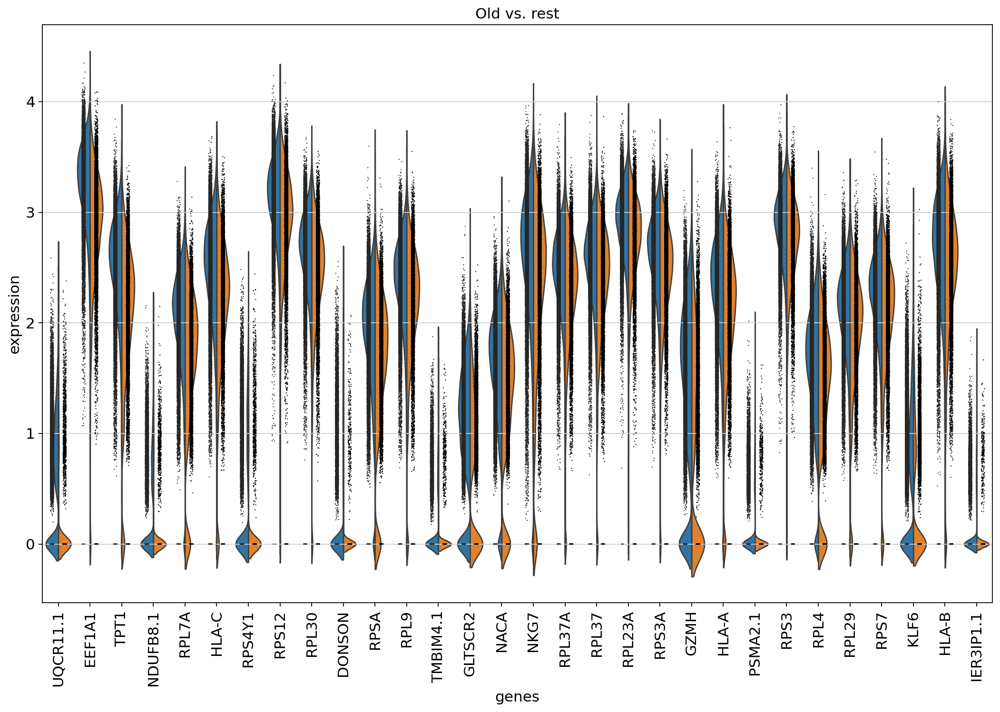

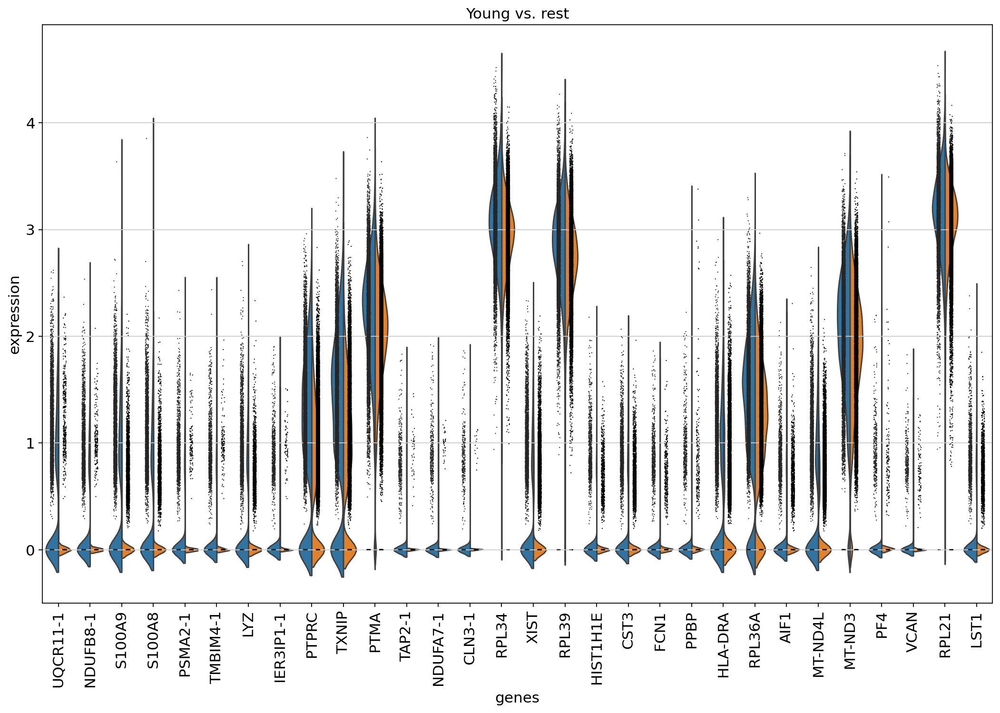

In [190]:
sc.set_figure_params(figsize=(16, 10), fontsize=14)
sc.pl.rank_genes_groups_violin(tregs, n_genes=30)

### pseudobulk DEA

In [197]:
import sc_toolbox

import rpy2.rinterface_lib.callbacks
import anndata2ri
import logging

from rpy2.robjects import pandas2ri
from rpy2.robjects import r

rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

pandas2ri.activate()
anndata2ri.activate()

%load_ext rpy2.ipython

The rpy2.ipython extension is already loaded. To reload it, use:
  %reload_ext rpy2.ipython


In [198]:
%%R
.libPaths("/home/student/R/x86_64-pc-linux-gnu-library/4.3")

library(edgeR)

Loading required package: limma
In addition: Warning message:
In (function (package, help, pos = 2, lib.loc = NULL, character.only = FALSE,  :
  libraries ‘/usr/local/lib/R/site-library’, ‘/usr/lib/R/site-library’ contain no packages


In [200]:
tregs = adata_cd8[adata_cd8.obs['dea_labels'] == 'CD8.Treg']

In [201]:
tregs

View of AnnData object with n_obs × n_vars = 25616 × 2000
    obs: 'pool_number', 'donor_id', 'ct_cov', 'age', 'sex', 'ethnicity', 'dataset', 'age_group', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'outlier', 'mt_outlier', 'n_genes', 'leiden', 'ct_annotation', 'ct_conf_score', 'is_CD8Treg', 'dea_labels', 'leiden_cd8'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'leiden', 'dendrogram_leiden', 'paga', 'leiden_sizes', 'umap', 'leiden_colors', 'sex_colors', 'dataset_colors', 'age_group_colors', 'ct_annotation_colors', 'ct_cov_colors', 'is_CD8Treg_colors', 'dea_labels_colors',

In [203]:
tregs.obs["bulk_sample"] = [
    f"{pool}_{age}" for pool, age in zip(tregs.obs["pool_number"], tregs.obs["age_group"])
]

In [204]:
tregs.obs["bulk_sample"] = tregs.obs["bulk_sample"].astype('category')
tregs.obs["pool_number"] = tregs.obs["pool_number"].astype('category')

In [205]:
def aggregate_and_filter(
    adata,
    # cell_identity,
    donor_key="bulk_sample",
    condition_key="age_group",
    # cell_identity_key="cell_type",
    obs_to_keep=[],  # which additional metadata to keep, e.g. gender, age, etc.
    replicates_per_patient=1,
    min_cells_per_donor=30
):
    """
    Creates an AnnData object with one pseudo-replicate for each donor for a specified 
    subpopulation from the original single-cell AnnData object. 
    Also it filters out donors that have fewer than `min_cells_per_donor' cells 
    for the specified population.

    By changing the `replicates_per_patient` parameter, 
    several (n) pseudo-replicates can be created for each sample; 
    cells are then split into n subsets of roughly equal sizes.
    """
    # subset adata to the given cell identity
    # adata_cell_pop = adata[adata.obs[cell_identity_key] == cell_identity].copy()
    adata_cell_pop = adata
    
    # check which donors to keep according to the number of cells specified with NUM_OF_CELL_PER_DONOR
    size_by_donor = adata_cell_pop.obs.groupby([donor_key]).size()
    donors_to_drop = [
        donor
        for donor in size_by_donor.index
        if size_by_donor[donor] <= min_cells_per_donor
    ]
    if len(donors_to_drop) > 0:
        print("Dropping the following samples:")
        print(donors_to_drop)
    df = pd.DataFrame(columns=[*adata_cell_pop.var_names, *obs_to_keep])

    adata_cell_pop.obs[donor_key] = adata_cell_pop.obs[donor_key].astype("category")
    
    for i, donor in enumerate(donors := adata_cell_pop.obs[donor_key].cat.categories):
        print(f"\tProcessing donor {i+1} out of {len(donors)}...", end="\r")
        
        if donor not in donors_to_drop:
            adata_donor = adata_cell_pop[adata_cell_pop.obs[donor_key] == donor]
            
            # create replicates for each donor
            indices = list(adata_donor.obs_names)
            random.shuffle(indices)
            indices = np.array_split(np.array(indices), replicates_per_patient)
            for i, rep_idx in enumerate(indices):
                adata_replicate = adata_donor[rep_idx]
                
                # specify how to aggregate: sum gene expression 
                # for each gene for each donor and also keep the condition information
                agg_dict = {gene: "sum" for gene in adata_replicate.var_names}
                for obs in obs_to_keep:
                    agg_dict[obs] = "first"
                    
                # create a df with all genes, donor and condition info
                df_donor = pd.DataFrame(adata_replicate.X.A)
                df_donor.index = adata_replicate.obs_names
                df_donor.columns = adata_replicate.var_names
                df_donor = df_donor.join(adata_replicate.obs[obs_to_keep])
                
                # aggregate
                df_donor = df_donor.groupby(donor_key).agg(agg_dict)
                df_donor[donor_key] = donor
                df.loc[f"donor_{donor}_{i}"] = df_donor.loc[donor]
    print("\n")
    
    # create AnnData object from the df
    adata_cell_pop = sc.AnnData(
        df[adata_cell_pop.var_names], obs=df.drop(columns=adata_cell_pop.var_names)
    )
    return adata_cell_pop

In [206]:
%%R
fit_model <- function(adata_){
    # create an edgeR object with counts and grouping factor
    y <- DGEList(assay(adata_, "X"), group = colData(adata_)$age_group)
    
    # filter out genes with low counts
    print("Dimensions before subsetting:")
    print(dim(y))
    print("")
    keep <- filterByExpr(y)
    y <- y[keep, , keep.lib.sizes=FALSE]
    print("Dimensions after subsetting:")
    print(dim(y))
    print("")

    # normalize
    y <- calcNormFactors(y)

    # create a vector that is a concatenation of condition and cell type 
    # that we will later use with contrasts
    ## group <- paste0(colData(adata_)$label, ".", colData(adata_)$cell_type)
    age_group <- colData(adata_)$age_group

    # create a design matrix: 
    # here we have multiple donors so also consider that in the design matrix
    design <- model.matrix(~ 0 + age_group)

    # estimate dispersion
    y <- estimateDisp(y, design = design)

    # fit the model
    fit <- glmQLFit(y, design)

    return(list("fit"=fit, "design"=design, "y"=y))
}

In [222]:
obs_to_keep = ['age', 'sex', 'pool_number', 'dataset', 'bulk_sample', 'age_group']

In [223]:
adata_to_bulk = tregs.copy()
adata_to_bulk.X = adata_to_bulk.layers['counts'].copy()

In [224]:
# process first cell type separately...
adata_pb = aggregate_and_filter(adata_to_bulk, obs_to_keep=obs_to_keep)
# for i, cell_type in enumerate(adata.obs["cell_type"].cat.categories[1:]):
#     print(
#         f'Processing {cell_type} ({i+2} out of {len(adata.obs["cell_type"].cat.categories)})...'
#     )
#     adata_cell_type = aggregate_and_filter(adata, cell_type, obs_to_keep=obs_to_keep)
#     adata_pb = adata_pb.concatenate(adata_cell_type)

Dropping the following samples:
['13.0_Young', '15.0_Young', '16.0_Young', '21.0_Young', '23.0_Young', '25.0_Young', '27.0_Young', '30.0_Young', '35.0_Young', '49.0_Young', '50.0_Young', '52.0_Young', '53.0_Young', '56.0_Old', '56.0_Young', '60.0_Old', '61.0_Young', '76.0_Old', '77.0_Young', '8.0_Young']
	Processing donor 142 out of 142...



In [225]:
adata_pb.obs['age'] = adata_pb.obs['age'].astype('int')
adata_pb.obs['pool_number'] = adata_pb.obs['pool_number'].astype('category')
adata_pb.obs['bulk_sample'] = adata_pb.obs['bulk_sample'].astype('category')
adata_pb.obs['age_group'] = adata_pb.obs['age_group'].astype('category')

In [226]:
adata_pb.layers['counts'] = adata_pb.X.copy()

sc.pp.normalize_total(adata_pb, target_sum=1e6)
sc.pp.log1p(adata_pb)
sc.pp.pca(adata_pb)

In [227]:
adata_pb.obs["lib_size"] = np.sum(adata_pb.layers["counts"], axis=1)
adata_pb.obs["lib_size"] = adata_pb.obs["lib_size"].astype('int')
adata_pb.obs["log_lib_size"] = np.log(adata_pb.obs["lib_size"])

... storing 'sex' as categorical
... storing 'dataset' as categorical


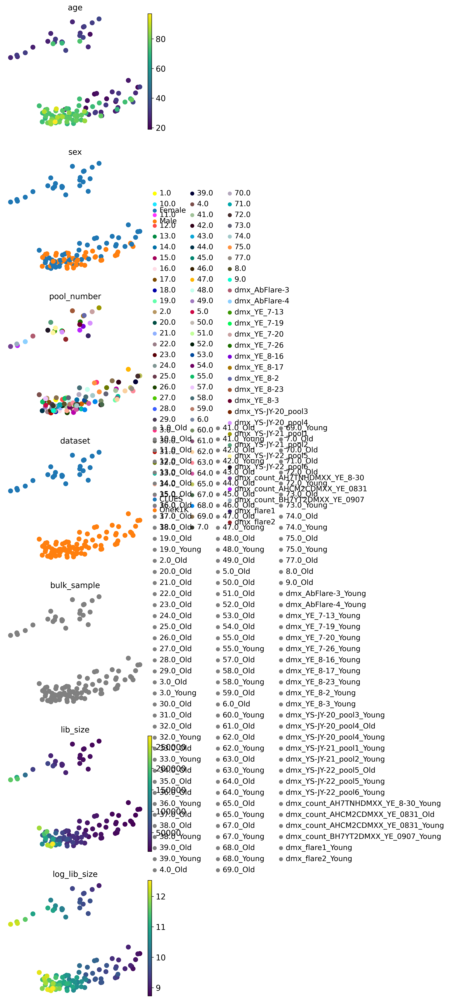

In [214]:
sc.pl.pca(adata_pb, color=adata_pb.obs, ncols=1, size=300)

In [228]:
adata_pb.X = adata_pb.layers['counts'].copy()

In [229]:
adata_pb.X = adata_pb.X.astype('float')
adata_pb.X = sparse.csr_matrix(adata_pb.X)

In [230]:
adata_pb.layers['counts'] = adata_pb.layers['counts'].astype('float')
adata_pb.layers['counts'] = sparse.csr_matrix(adata_pb.layers['counts'])

In [231]:
%%time
%%R -i adata_pb
outs <-fit_model(adata_pb)

[1] "Dimensions before subsetting:"
[1] 2000  122
[1] ""
[1] "Dimensions after subsetting:"
[1] 225 122
[1] ""
CPU times: user 699 ms, sys: 28.6 ms, total: 727 ms
Wall time: 723 ms


In [232]:
%%R
fit <- outs$fit
y <- outs$y

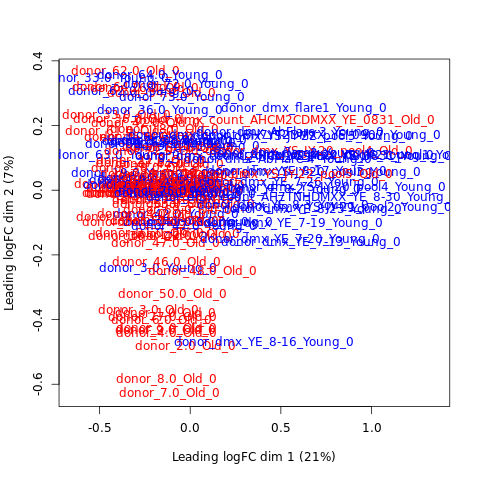

In [234]:
%%R
plotMDS(y, col=ifelse(y$samples$group == "Old", "red", "blue"))

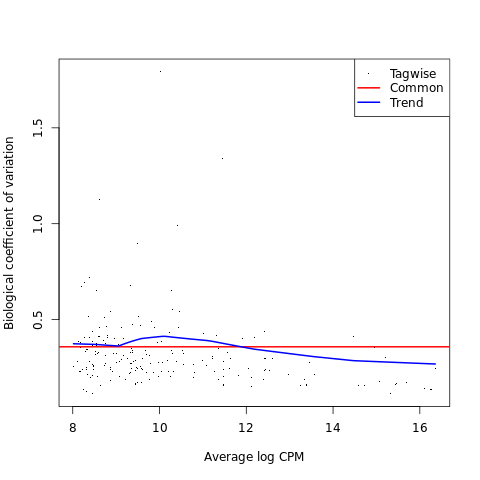

In [235]:
%%R
plotBCV(y)

In [236]:
%%R
colnames(y$design)

[1] "age_groupOld"   "age_groupYoung"


In [276]:
%%R -o tt
# pairs <- c("cell_typeCD8.Treg-cell_typeCD8.EM", "cell_typeCD8.Treg-cell_typeCD8.TE",
#            "cell_typeCD8.Treg-cell_typeCD8.Naive", "cell_typeCD8.Treg-cell_typeMAIT")
myContrast <- makeContrasts(contrasts="age_groupOld-age_groupYoung", levels = y$design)
qlf <- glmQLFTest(fit, contrast=myContrast)
# get all of the DE genes and calculate Benjamini-Hochberg adjusted FDR
tt <- topTags(qlf, n = Inf, adjust.method='fdr', p.value=0.05)
tt <- tt$table

In [273]:
tt.shape

(115, 5)

In [277]:
tt['name'] = tt.index.tolist()
tt = tt[~tt.name.str.startswith('RP')]

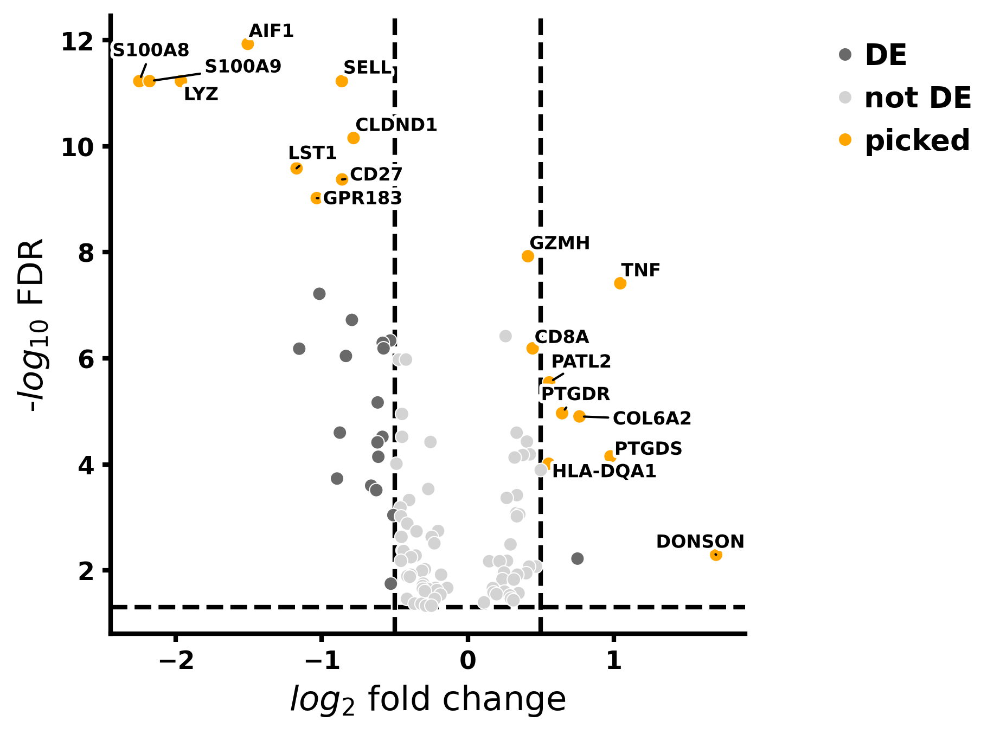

In [278]:
from sanbomics.plots import volcano
volcano(tt, log2fc='logFC', pvalue='FDR', symbol='name', to_label=9, 
        log2fc_thresh=0.5, fontsize=8, colors=['dimgrey', 'lightgrey', 'orange'], save='ages_volcano')

In [255]:
with open('up_ages.txt', 'w') as f:
    for gene in tt[tt.logFC > 0].name.tolist():
        f.write(f'{gene}\n')

In [256]:
with open('down_ages.txt', 'w') as f:
    for gene in tt[tt.logFC < 0].name.tolist():
        f.write(f'{gene}\n')

In [250]:
tt

,logFC,logCPM,F,PValue,FDR,name
AIF1,-1.506925,8.444079,79.051328,5.180690e-15,1.165655e-12,AIF1
SELL,-0.862765,9.770048,69.403158,1.128755e-13,5.872621e-12,SELL
LYZ,-1.964371,9.491482,69.379468,1.137545e-13,5.872621e-12,LYZ
S100A8,-2.249553,10.035503,69.363587,1.143477e-13,5.872621e-12,S100A8
S100A9,-2.179145,10.424559,68.960521,1.305027e-13,5.872621e-12,S100A9
CLDND1,-0.782619,9.438197,61.041774,1.856998e-12,6.963741e-11,CLDND1
LST1,-1.172699,8.730556,56.803487,8.074183e-12,2.595273e-10,LST1
CD27,-0.861045,10.037700,55.057704,1.494626e-11,4.203635e-10,CD27
GPR183,-1.034448,8.392864,52.455163,3.786926e-11,9.467315e-10,GPR183
GZMH,0.411602,13.576995,45.305666,5.252365e-10,1.181782e-08,GZMH
